In [ ]:
from PIL import Image
import numpy as np
import os
import matplotlib.pyplot as plt
from scipy.ndimage import filters
from scipy.ndimage import measurements, morphology

In [ ]:
def get_imlist(path):
  return [os.path.join(path, f) for f in os.listdir(path) 
                                    if f.endswith('.jpg') or f.endswith('.png')]
def imresize(im, size):
  pil_im = Image.fromarray(np.uint8(im))
  return(np.array(pil_im.resize(size)))

def histeq(im, nbr_bins = 256):
  imhist, bins = np.histogram(im.flatten(), nbr_bins, normed = True)
  cdf = imhist.cumsum()
  cdf = 255 * cdf / cdf[-1]
  im2 = np.interp(im.flatten(), bins[:-1], cdf)
  return im2.reshape(im.shape), cdf

def computate_average(imlist):
  averageim = np.array(Image.open(imlist[0]), 'f')
  for i in imlist[1:]:
    try:
      averageim += np.array(Image.open(i))
    except:
      print('can\'t open' + i)
  averageim /= len(imlist)
  return np.array(averageim, 'uitn8')

def pca(x):
  num_data, dim = x.shape
  mean_x = x.mean(axis = 0)
  x = x - mean_x
  if dim > num_data:
    m = dot(x, x.T)
    e, ev = np.linalg.eigh(m)
    tmp = dot(x.T, ev).T
    v = tmp[::-1]
    s = sqrt(e)[::-1]
    for i in range(v.shape[1]):
      v[:, i] /= s
  else:
    u, s, v = np.linalg.svd(x)
    v = v[:num_data]
  return v, s, mean_x


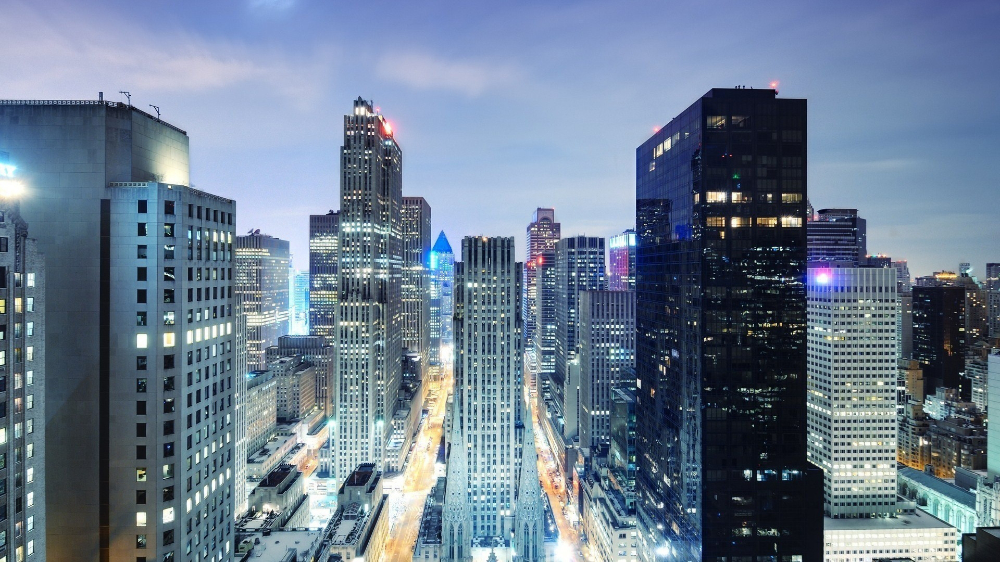

In [ ]:
pil_im = Image.open('panoram.jpg')
pil_im

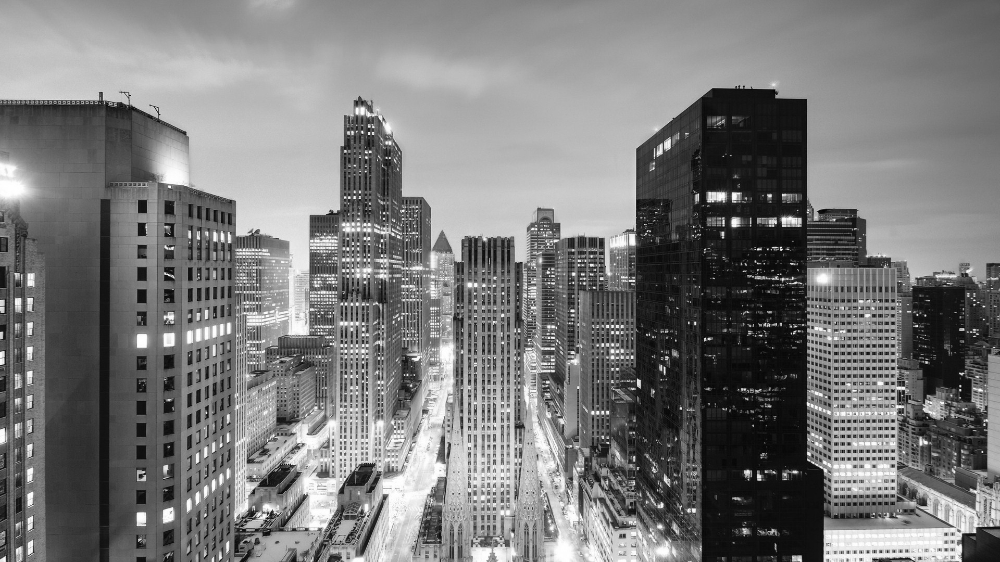

In [ ]:
pil_im = Image.open('panoram.jpg').convert('L')
pil_im

In [ ]:
filelist = ['panoram.jpg']
for infile in filelist:
  outfile = os.path.splitext(infile)[0] + '.png'
  if infile != outfile:
    try:
      Image.open(infile).save(outfile)
    except IOError:
      print("Не могу преобразовать", infile)

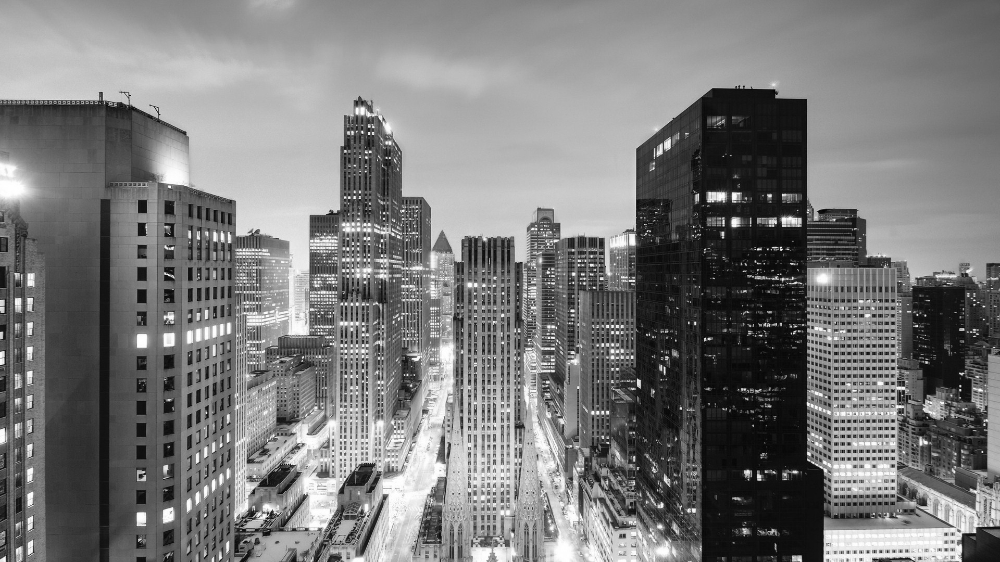

In [ ]:
pil_im = Image.open('panoram.png').convert('L')
pil_im

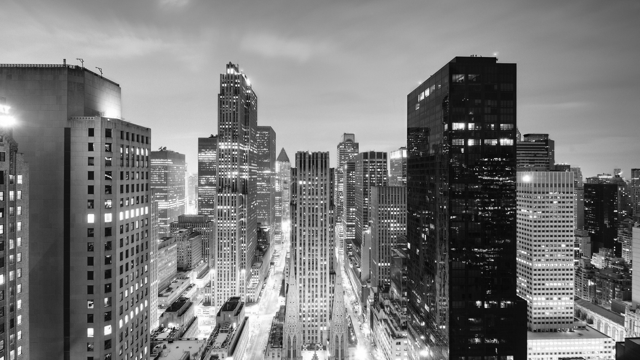

In [ ]:
pil_im.thumbnail((640, 360))
pil_im

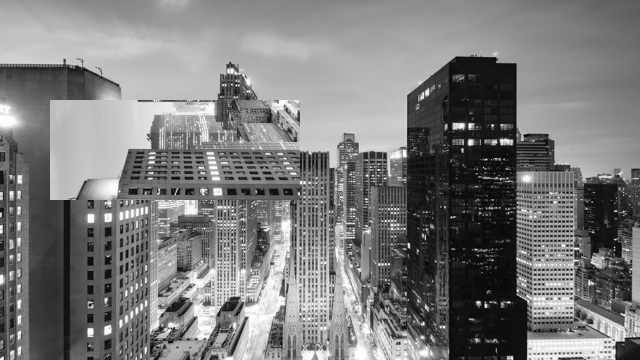

In [ ]:
box = (100,50,200,300)
region = pil_im.crop(box)
region = region.transpose(Image.ROTATE_90)
pil_im.paste(region, (50,100,300,200))
pil_im

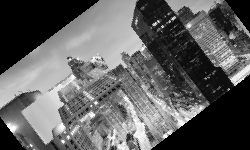

In [ ]:
out = pil_im.resize((250, 150)).rotate(37)
out

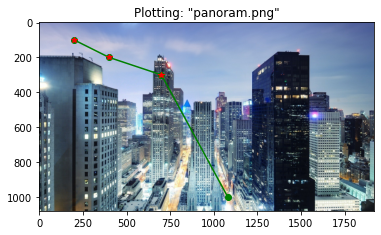

In [ ]:
im = np.array(Image.open('panoram.png'))
plt.imshow(im)
x = [200, 400, 700, 1080]
y = [100, 200, 300, 1000]
plt.plot(x, y, 'go-')
plt.plot(x[:3], y[:3], 'r*')
plt.title('Plotting: "panoram.png"')
plt.show()

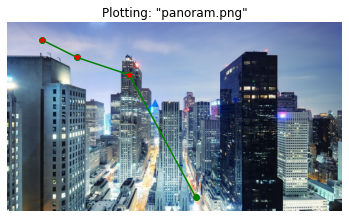

In [ ]:
im = np.array(Image.open('panoram.png'))
plt.imshow(im)
x = [200, 400, 700, 1080]
y = [100, 200, 300, 1000]
plt.plot(x, y, 'go-')
plt.plot(x[:3], y[:3], 'r*')
plt.title('Plotting: "panoram.png"')
plt.axis('off')
plt.show()

(0.5, 1919.5, 0.5, 1079.5)

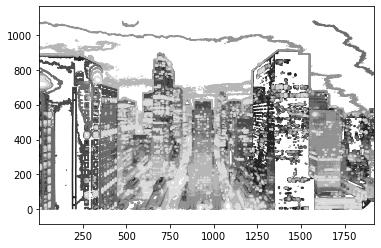

In [ ]:
im = np.array(Image.open('panoram.png').convert('L'))
plt.figure()
plt.gray()
plt.contour(im, origin = 'image')
plt.axis('equal')

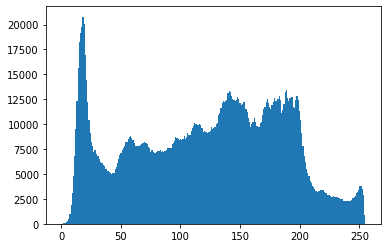

In [ ]:
plt.figure()
plt.hist(im.flatten(), 256)
plt.show()

In [ ]:
im = np.array(Image.open('panoram.jpg'))
print(im.shape, im.dtype)

(1080, 1920, 3) uint8


In [ ]:
im = np.array(Image.open('panoram.jpg').convert('L'), 'f')
print(im.shape, im.dtype)

(1080, 1920) float32


In [ ]:
im = np.array(Image.open('panoram.jpg').convert('L'))
im2 = 255 - im
im3 = (127.0 / 255) * im + 128
im4 = 255.0 * (im / 255.0) ** 2

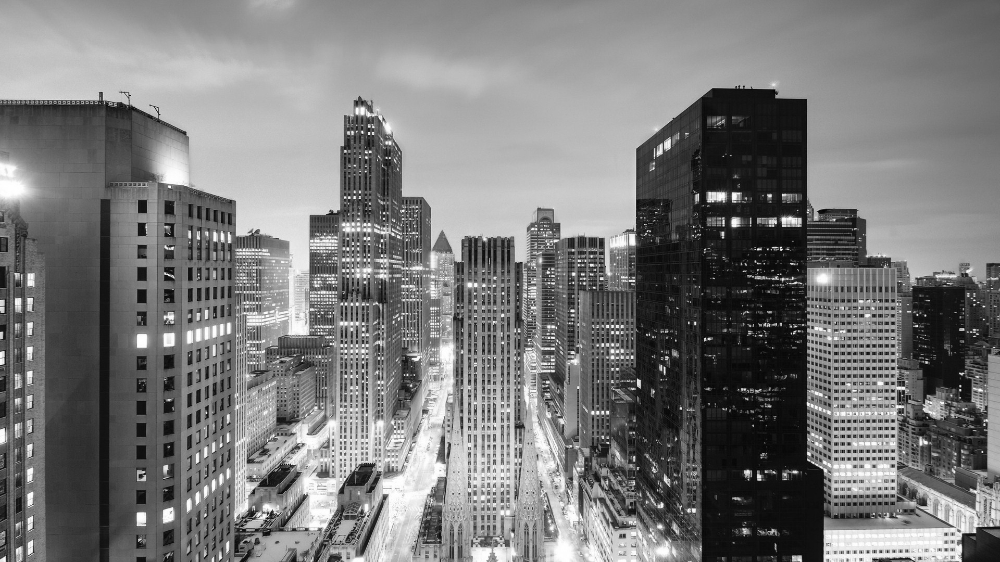

In [ ]:
pil_im = Image.fromarray(im)
pil_im

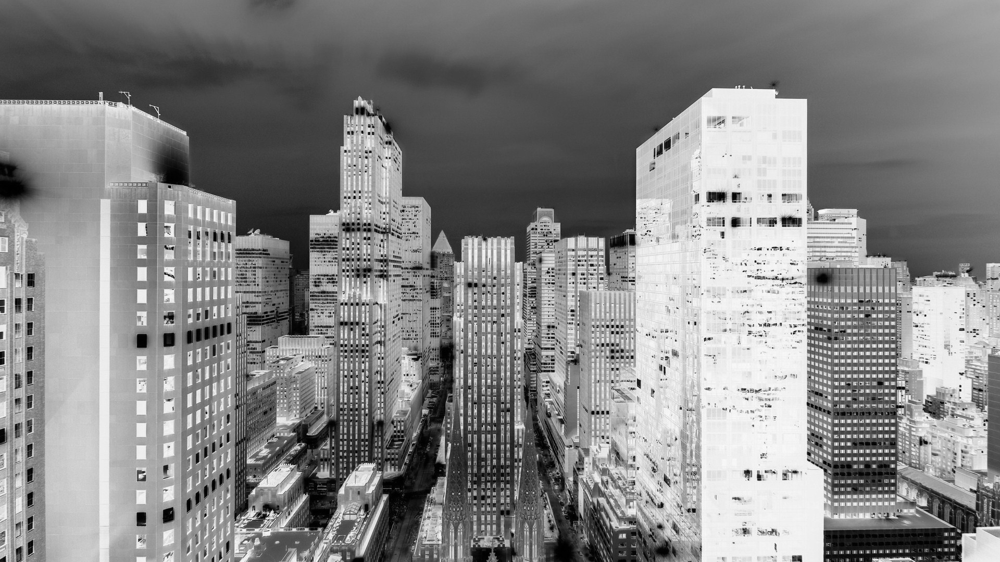

In [ ]:
pil_im = Image.fromarray(im2)
pil_im

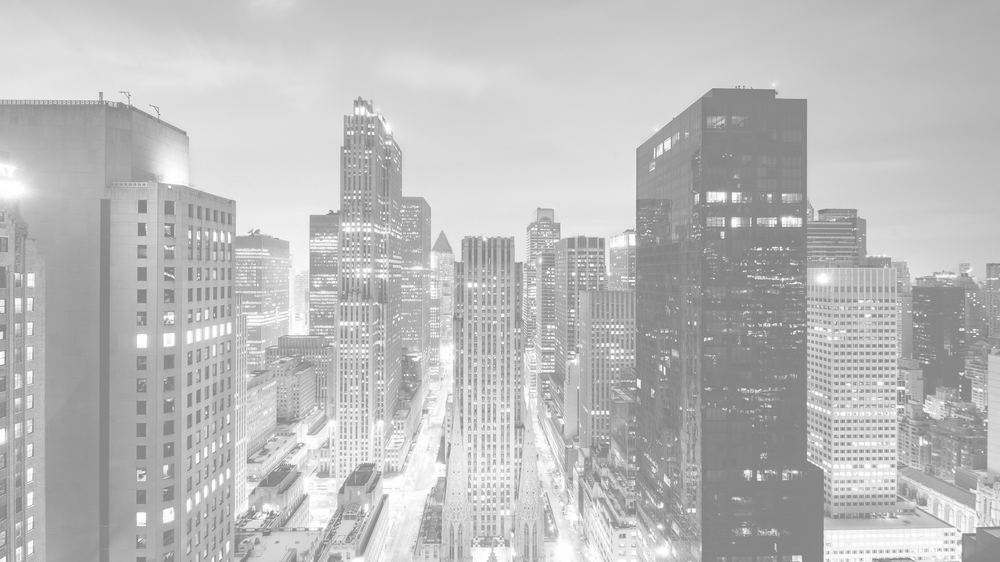

In [ ]:
pil_im = Image.fromarray(np.uint8(im3))
pil_im

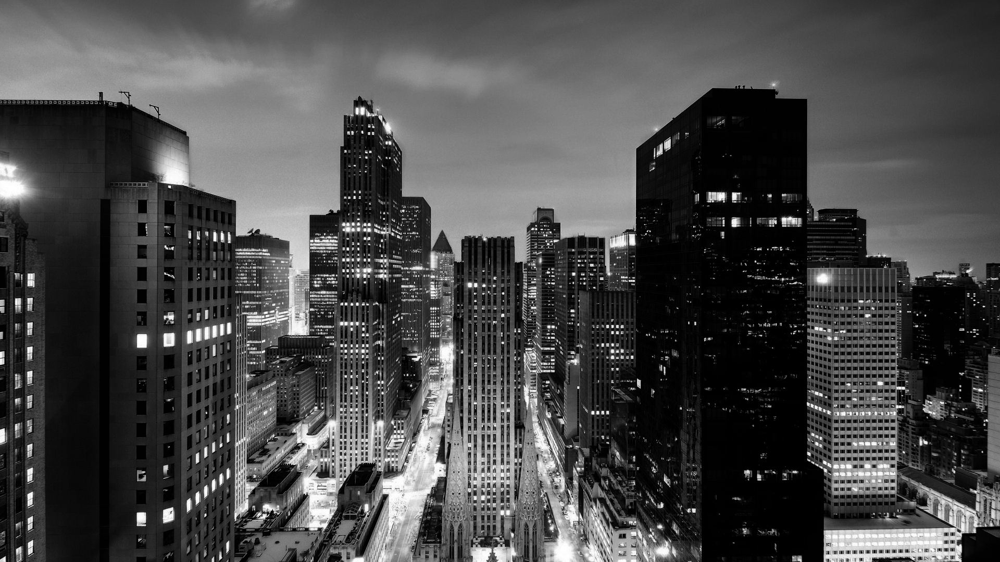

In [ ]:
pil_im = Image.fromarray(np.uint8(im4))
pil_im

In [ ]:
im = np.array(Image.open('panoram.jpg').convert('L'))
im2, cdf = histeq(im)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Passing `normed=True` on non-uniform bins has always been broken, and computes neither the probability density function nor the probability mass function. The result is only correct if the bins are uniform, when density=True will produce the same result anyway. The argument will be removed in a future version of numpy.
  if __name__ == '__main__':


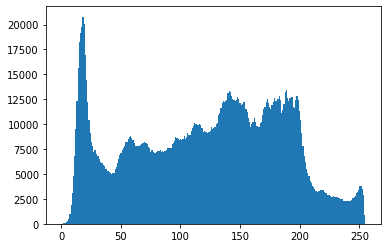

In [ ]:
plt.figure()
plt.hist(im.flatten(), 256)
plt.show()

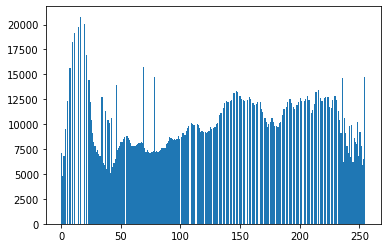

In [ ]:
plt.figure()
plt.hist(im2.flatten(), 256)
plt.show()

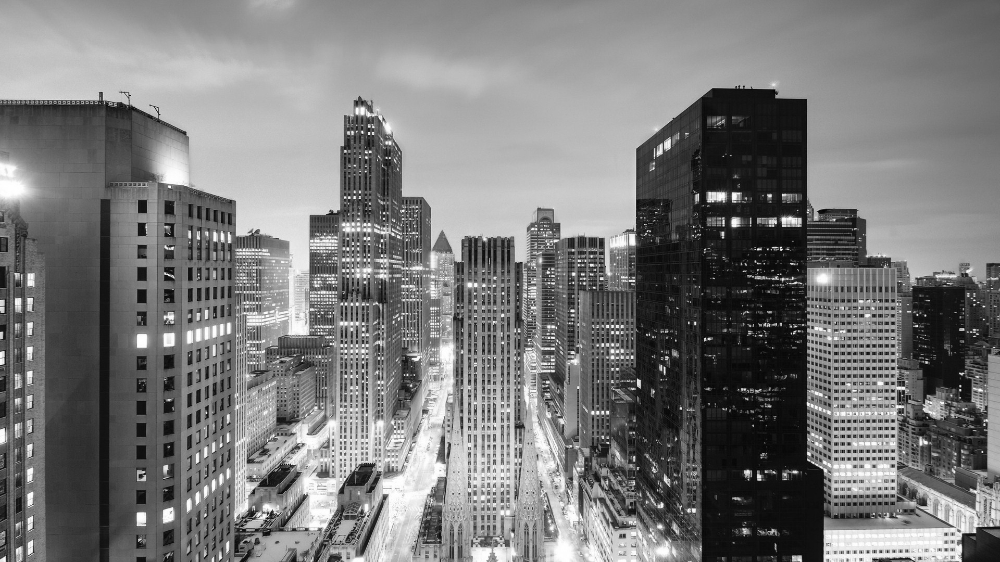

In [ ]:
Image.fromarray(im)

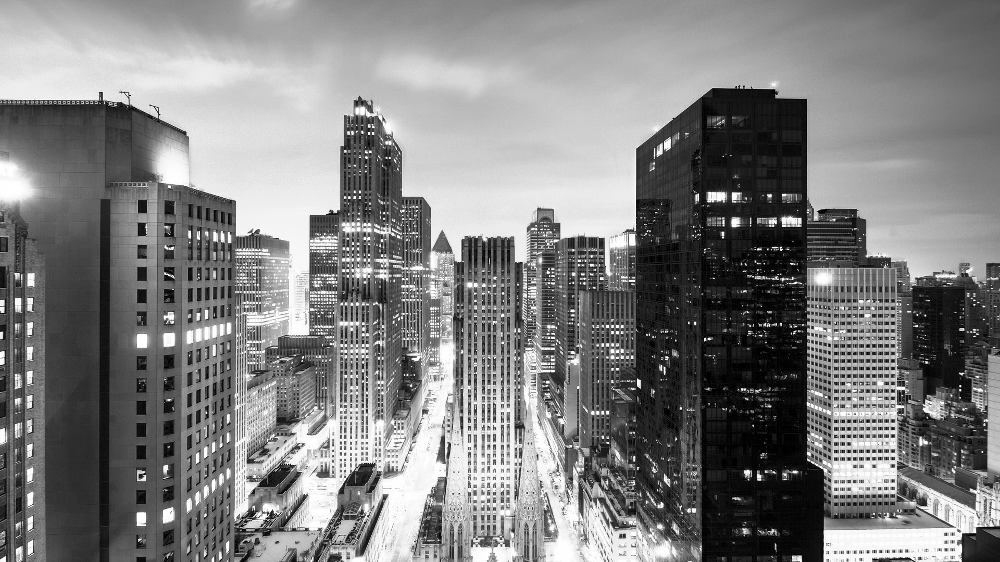

In [ ]:
Image.fromarray(np.uint8(im2))

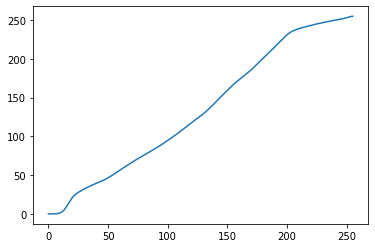

In [ ]:
plt.plot(cdf)

In [ ]:
im = np.array(Image.open('panoram.jpg').convert('L'))
im2 = filters.gaussian_filter(im, 5)

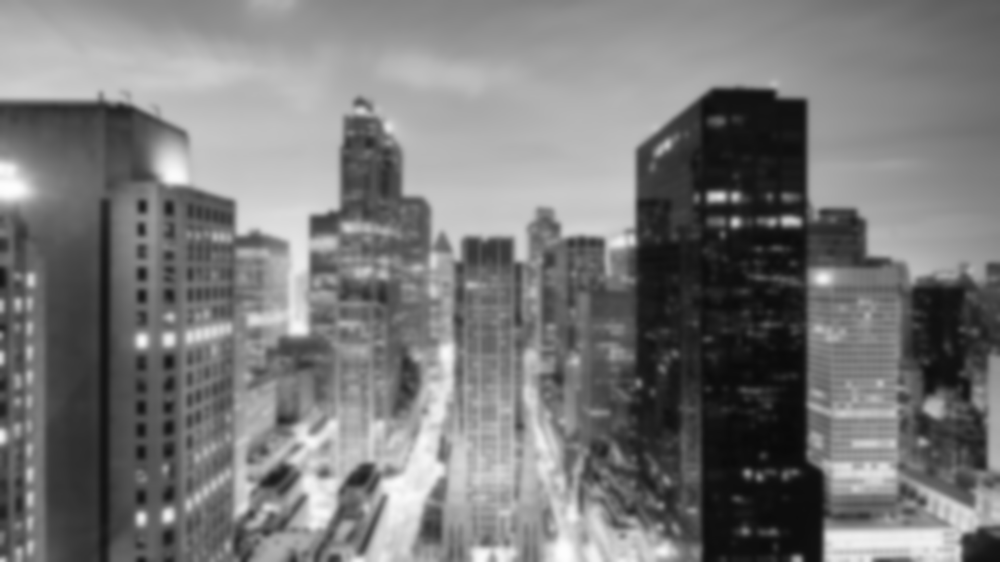

In [ ]:
Image.fromarray(im2)

In [ ]:
im = np.array(Image.open('panoram.jpg'))
im2 = np.zeros(im.shape)
for i in range(3):
  im2[:,:,i] = filters.gaussian_filter(im[:,:,i], 5)
im2 = np.uint8(im2)

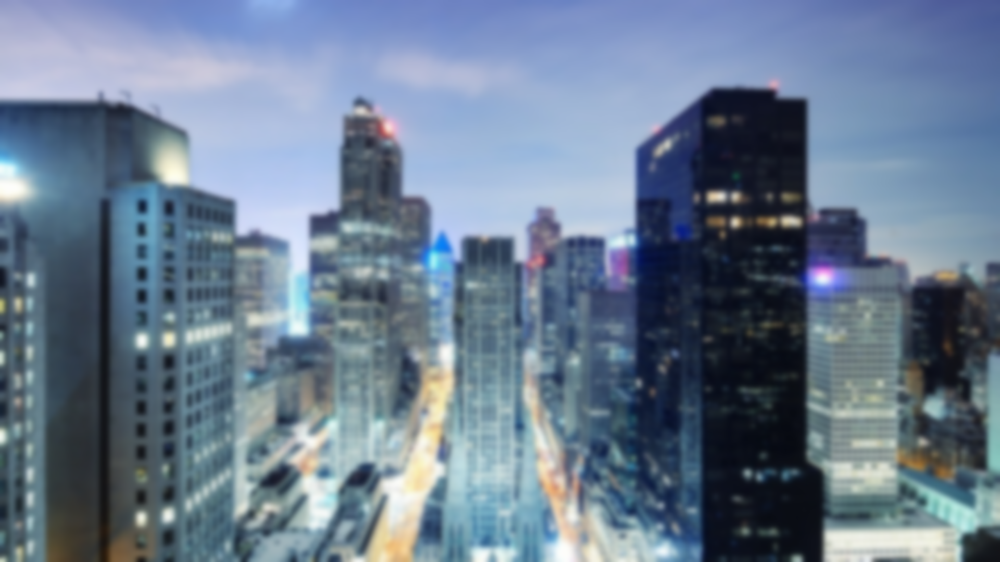

In [ ]:
Image.fromarray(im2)

In [ ]:
im = np.array(Image.open('panoram.jpg').convert('L'))
imx = np.zeros(im.shape)
filters.sobel(im, 1, imx)
imy = np.zeros(im.shape)
filters.sobel(im, 0, imy)
magnitude = np.sqrt(imx ** 2 + imy ** 2)

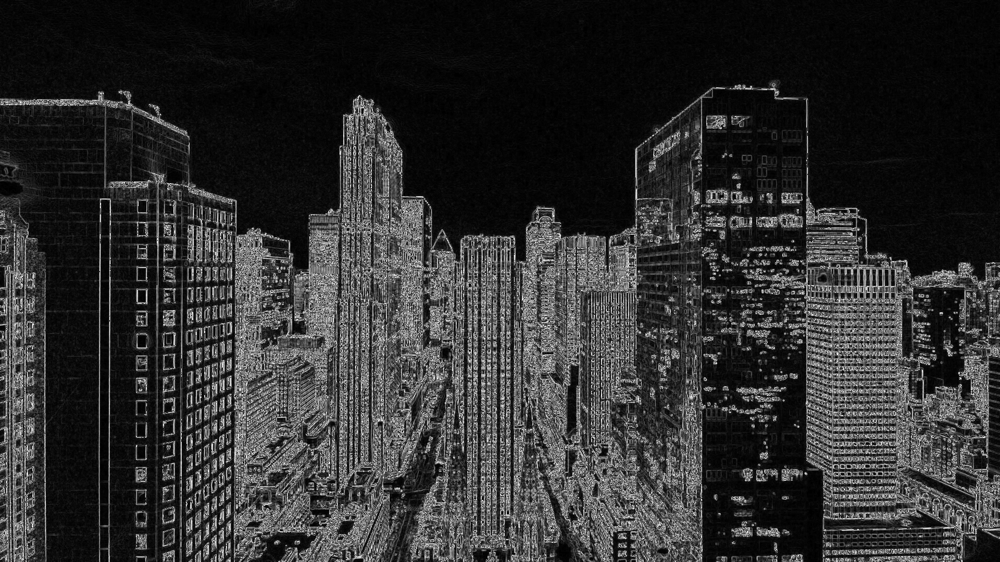

In [ ]:
Image.fromarray(np.uint8(magnitude))

In [ ]:
sigma = 5
imx = np.zeros(im.shape)
filters.gaussian_filter(im, (sigma, sigma), (1, 0), imx)
imy = np.zeros(im.shape)
filters.gaussian_filter(im, (sigma, sigma), (1, 0), imy)
magnitude = np.sqrt(imx ** 2 + imy ** 2)

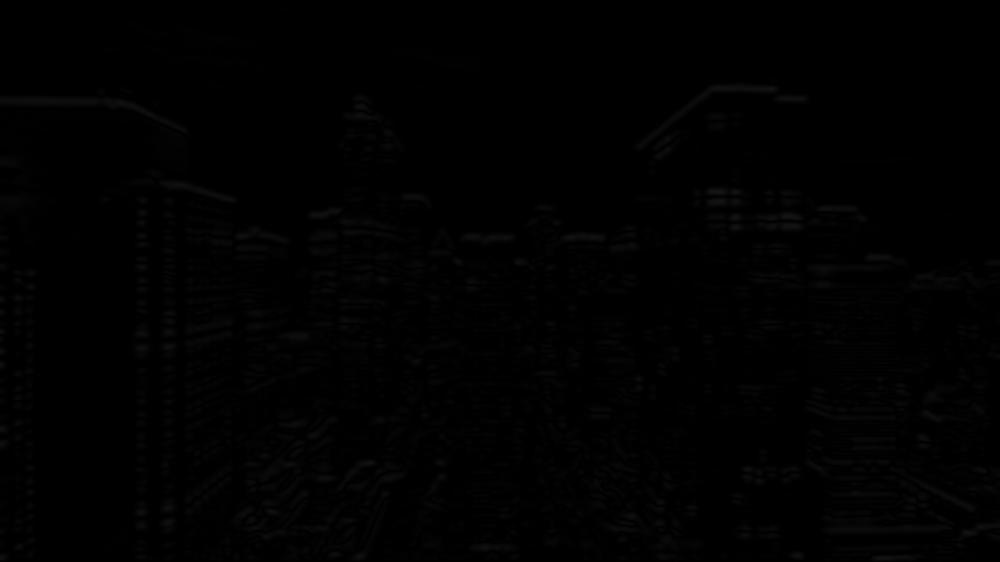

In [ ]:
Image.fromarray(np.uint8(magnitude))

In [ ]:
im = np.array(Image.open('circles.png').convert('L'))
im = 1 * (im < 128)
labels, nbr_objects = measurements.label(im)
print("Obj count = ", nbr_objects)

Obj count =  7


In [ ]:
im_open = morphology.binary_opening(im, np.ones((9, 5)), iterations = 2)
labels_open, nbr_objects_open = measurements.label(im_open)
print("Obj count = ", nbr_objects_open)

Obj count =  7
